In [1]:
#IMPORTS
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn

import torchvision

In [2]:
imgSize = 64
filter = torchvision.transforms.Compose([torchvision.transforms.Resize(imgSize), torchvision.transforms.CenterCrop(imgSize), torchvision.transforms.ToTensor(), torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

#GET DATA
trainData = torchvision.datasets.StanfordCars("images/cars", split = "train", transform = filter, download = True)#DownloadData

In [3]:
#LOAD DATA
BATCHSIZE = 128
NUMWORKERS = 8

loadedTrainData = torch.utils.data.DataLoader(trainData, batch_size = BATCHSIZE, shuffle = True, num_workers = NUMWORKERS)#LoadData

In [5]:
ND = 128

inputChannels = 3
NDF = ND #num discriminator features
#DEFINE MODEL

def initilize_weights(layer):
  layer_name = layer.__class__.__name__
  if layer_name.find("Conv") != -1:
    nn.init.normal_(layer.weight.data, 0, 0.02)
  if layer_name.find("BatchNorm") != -1:
    nn.init.normal_(layer.weight.data, 1, 0.02)
    nn.init.constant_(layer.bias.data, 0)

class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()

    self.block1 = nn.Sequential(nn.Conv2d(inputChannels, NDF, 4, 2, 1, bias = False), nn.LeakyReLU(0.2))
    self.block2 = nn.Sequential(nn.Conv2d(NDF, NDF, 5, 1, 2, bias = False), nn.BatchNorm2d(NDF), nn.LeakyReLU(0.2), nn.Conv2d(NDF, NDF*2, 4, 2, 1, bias = False), nn.BatchNorm2d(NDF*2), nn.LeakyReLU(0.2))
    self.block3 = nn.Sequential(nn.Conv2d(NDF*2, NDF*2, 5, 1, 2, bias = False), nn.BatchNorm2d(NDF*2), nn.LeakyReLU(0.2), nn.Conv2d(NDF*2, NDF*4, 4, 2, 1, bias = False), nn.BatchNorm2d(NDF*4), nn.LeakyReLU(0.2))
    self.block4 = nn.Sequential(nn.Conv2d(NDF*4, NDF*4, 3, 1, 1, bias = False), nn.BatchNorm2d(NDF*4), nn.LeakyReLU(0.2), nn.Conv2d(NDF*4, NDF*8, 4, 2, 1, bias = False), nn.BatchNorm2d(NDF*8), nn.LeakyReLU(0.2))
    self.block5 = nn.Sequential(nn.Conv2d(NDF*8, 1, 4, bias = False), nn.Sigmoid())

  def forward(self, x):
    x = self.block1(x)
    #print("DIS", x.shape)
    x = self.block2(x)
    #print("DIS", x.shape)
    x = self.block3(x)
    #print("DIS", x.shape)
    x = self.block4(x)
    #print("DIS", x.shape)
    x = self.block5(x)
    #print("-------------------------")
    return x

noiseChannels = 100
NGF = ND
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()

    self.block1 = nn.Sequential(nn.ConvTranspose2d(noiseChannels, NGF*8, 4, 1, 0, bias = False), nn.BatchNorm2d(NGF*8), nn.ReLU())
    self.block2 = nn.Sequential(nn.ConvTranspose2d(NGF*8, NGF*4, 4, 2, 1, bias = False), nn.BatchNorm2d(NGF*4), nn.ReLU(), nn.Conv2d(NGF*4, NGF*4, 3, 1, 1, bias = False), nn.BatchNorm2d(NGF*4), nn.ReLU())
    self.block3 = nn.Sequential(nn.ConvTranspose2d(NGF*4, NGF*2, 4, 2, 1, bias = False), nn.BatchNorm2d(NGF*2), nn.ReLU(), nn.Conv2d(NGF*2, NGF*2, 3, 1, 1, bias = False), nn.BatchNorm2d(NGF*2), nn.ReLU())
    self.block4 = nn.Sequential(nn.ConvTranspose2d(NGF*2, NGF, 4, 2, 1, bias = False), nn.BatchNorm2d(NGF), nn.ReLU(), nn.Conv2d(NGF, NGF, 3, 1, 1, bias = False), nn.BatchNorm2d(NGF), nn.ReLU())
    self.block5 = nn.Sequential(nn.ConvTranspose2d(NGF, inputChannels, 4, 2, 1, bias = False), nn.Tanh())

  def forward(self, x):
    x = self.block1(x)
    #print("GEN", x.shape)
    x = self.block2(x)
    #print("GEN", x.shape)
    x = self.block3(x)
    #print("GEN", x.shape)
    x = self.block4(x)
    #print("GEN", x.shape)
    x = self.block5(x)
    #print("-------------------------")
    return x

In [6]:
#BUILD MODEL
gen = Generator()
disc = Discriminator()
loss_fn = torch.nn.BCELoss()#CrossEntropyLossFunction
gen_optimizer = torch.optim.Adam(gen.parameters(), lr = .0002, betas = (0.5, 0.999))
disc_optimizer = torch.optim.Adam(disc.parameters(), lr = .0002, betas = (0.5, 0.999))

gen.apply(initilize_weights)
disc.apply(initilize_weights)

Discriminator(
  (block1): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2)
  )
  (block2): Sequential(
    (0): Conv2d(128, 128, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
  )
  (block3): Sequential(
    (0): Conv2d(256, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05,

In [7]:
#MOVE TO GPU
num_gpus = 1
device = "cuda" if torch.cuda.is_available() else "cpu"#IfCudaIsEnabled
gen = gen.to(device)#MoveModelToGPUStorage
disc = disc.to(device)
if device == "cuda" and num_gpus > 1: 
  print("Will train on multiple GPUS")
  gen = nn.DataParallel(gen, list(range(num_gpus)))
  disc = nn.DataParallel(disc, list(range(num_gpus)))

device

'cuda'

In [8]:
#TRAIN MODEL
images = []
EPOCHS = 500
PRINTFREQ = 100
NOISE = torch.randn(64, noiseChannels, 1, 1, device = device)

GEN_LOSSES = []
DICS_LOSSES = []

import torchvision.utils as utils

batches = 0
for e in range(EPOCHS):
  epochLoss = 0
  for batchX, _ in loadedTrainData:
    batchX = batchX.to(device)

    batches += 1

    real_labels = torch.full((batchX.size(0),), 1, dtype=torch.float, device = device)
    fake_labels = torch.full((batchX.size(0),), 0, dtype=torch.float, device = device)
    
    

    #TRAIN REAL IMGS
    disc_optimizer.zero_grad()#ResetGradients
    disc_output = disc(batchX)#RunThroughModel
    disc_real_loss = loss_fn(disc_output.view(-1), real_labels)#ComputeLoss
    disc_real_loss.backward()#ComputeGradients
    disc_real_mean = disc_output.mean().item()

    
    #TRAIN FAKE IMGS
    fake_imgs = gen(torch.randn(batchX.size(0), noiseChannels, 1, 1, device = device))
    disc_fake_output = disc(fake_imgs.detach())
    disc_fake_loss = loss_fn(disc_fake_output.view(-1), fake_labels)
    disc_fake_loss.backward()
    disc_fake_mean = disc_fake_output.mean().item()

    disc_loss = disc_fake_loss + disc_real_loss

    disc_optimizer.step()#UpdateParametersBasedOnGradient

    #TRAIN GENERATOR
    gen_optimizer.zero_grad()
    disc_gen_output = disc(fake_imgs)
    gen_loss = loss_fn(disc_gen_output.view(-1), real_labels)
    gen_loss.backward()
    gen_optimizer.step()
    
    
    DICS_LOSSES.append(disc_loss)
    GEN_LOSSES.append(gen_loss)
    
    if batches % PRINTFREQ == 0:
      print(f"Epoch : {e} Batch : {batches}  Disc Loss : {disc_loss} Gen Loss : {gen_loss} Average Real Guess : {disc_real_mean} Average Fake Guess : {disc_fake_mean}")
    
    if batches % 500 == 0:
      images.append(utils.make_grid(gen(NOISE), padding = 2, normalize = True))


Epoch : 1 Batch : 100  Disc Loss : 0.7990463376045227 Gen Loss : 2.495576858520508 Average Real Guess : 0.6559340953826904 Average Fake Guess : 0.05532938987016678
Epoch : 3 Batch : 200  Disc Loss : 0.32640939950942993 Gen Loss : 4.2369537353515625 Average Real Guess : 0.8407660126686096 Average Fake Guess : 0.08513499796390533
Epoch : 4 Batch : 300  Disc Loss : 0.27496474981307983 Gen Loss : 5.821011066436768 Average Real Guess : 0.8968235850334167 Average Fake Guess : 0.11074498295783997
Epoch : 6 Batch : 400  Disc Loss : 1.3884663581848145 Gen Loss : 5.546098709106445 Average Real Guess : 0.8829522132873535 Average Fake Guess : 0.39431312680244446
Epoch : 7 Batch : 500  Disc Loss : 1.2571367025375366 Gen Loss : 6.997818946838379 Average Real Guess : 0.44962430000305176 Average Fake Guess : 0.0008306859526783228
Epoch : 9 Batch : 600  Disc Loss : 1.5550401210784912 Gen Loss : 3.9628746509552 Average Real Guess : 0.8824265003204346 Average Fake Guess : 0.6646937131881714
Epoch : 10 Ba

KeyboardInterrupt: 

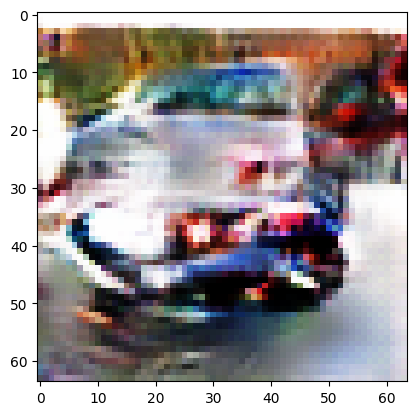

In [70]:
plt.imshow((gen(torch.randn(1, noiseChannels, 1, 1, device = device)).cpu().detach()[0].permute([1, 2, 0]) + 1) / 2)

Animation size has reached 21856756 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


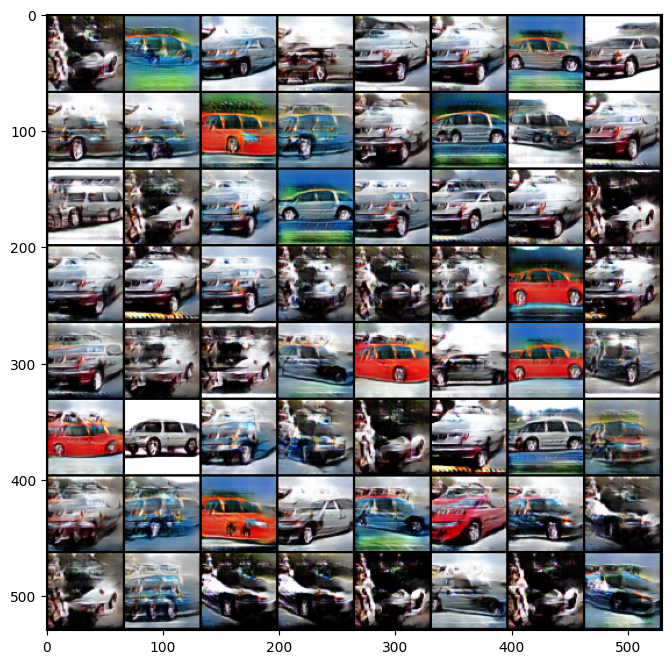

In [71]:
fig = plt.figure(figsize = (8, 8))
images = [[plt.imshow(np.transpose(i.cpu(),(1, 2, 0)), animated = True)] for i in images]

import matplotlib.animation as animation
from IPython.display import HTML

var = animation.ArtistAnimation(fig, images, interval = 1000, repeat_delay = 1000, blit = True)

HTML(var.to_jshtml())

In [72]:
torch.save(gen, "./genSave.model")